##Submitted by:
*   Nathan Migdashiev 316147719
*   Yuval Praiss 312501059
*   Yonatan Frenkel 205936198


## **Landscape Colorizing pictures using GAN**

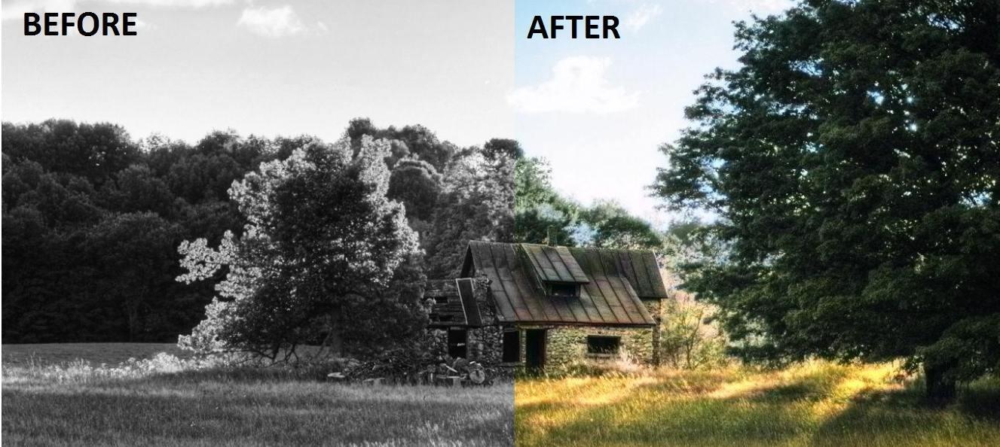

After scouring the web for quite some time in search of an interesting topics for our project, we stumbled upon a paper, which you may know by the name '[pix2pix](https://arxiv.org/pdf/1611.07004.pdf)'.
Intrigued by its name, we decided to check it out and we were immediately hooked-in.
The challenge of adding color to black and white images while achieving accurate and visually appealing colorization results, requires significant effort and expertise.
And thats the exact reason why we chose this project!
We decided to explore the 'landscape colorization' task and try to implement it, using a GAN-based model.
In this project we hope to build and train a landscape colorization model that can generate as high-quality and as realistic colorized images as possible.
Here. We. Go!

# The Data

Our project is based on the 'Image-to-Image Translation with Conditional Adversarial Networks' (pix2pix) paper, and on the 'Landscape Colorizer - Pix2PixGAN' [Kaggle](https://www.kaggle.com/datasets/theblackmamba31/landscape-image-colorization) project.
While the Kaggle project itself uses a dataset of over 7000 colorful and over 7000 same black and white landscape images, we decided to proceed with only the colorful images. The main reason for our deciesion: RGB vs L*a*b.
You can download the data straight for the link above.

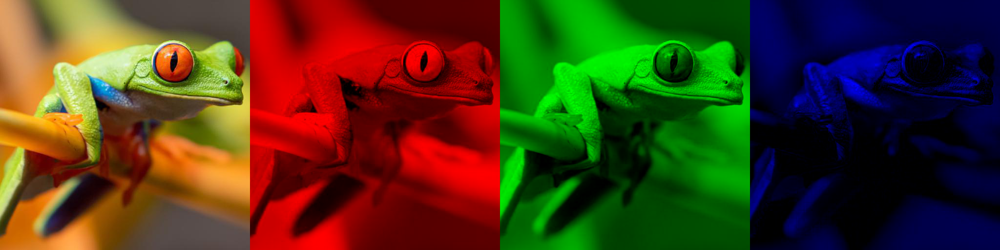

After an extensive research we came to an conclusion that most people use L*a*b color space instead of RGB to train the models, and here is why:
Picture this: you've got a black-and-white photo that's begging for a little TLC, and you want to train a model to do the heavy lifting for you. With Lab, you can just feed the "L" channel (that's the grayscale image) to your model and watch it work its magic, predicting the a and b channels to bring the color back to life. But if you're using RGB, you've got to first convert your image to grayscale, then pray that your model can predict three numbers for each pixel instead of just two. And with 256 possible choices for each number in an 8-bit unsigned integer image, that's like trying to choose between 16 million different combos. Ain't nobody got time for that! Stick with Lab, and your colorization dreams will come true.

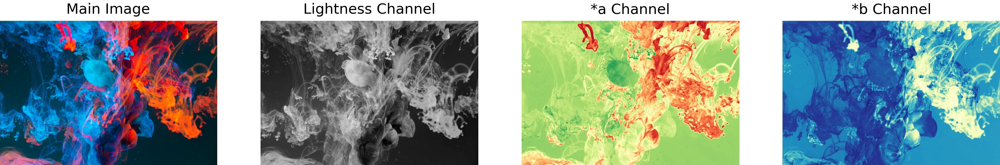

#1.1. Imports





In [1]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb
from skimage.metrics import structural_similarity as ssim
!pip install --upgrade torchvision


import torch
from torch import nn, optim
import torch.nn.functional as F
import torchvision
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
use_colab = None

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [2]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


Categorizing and organizing the Data to a subset of the images as the training and validation sets.

In [6]:
path = '/content/gdrive/My Drive/colorozation data/color/'   
paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names

np.random.seed(10)
paths_subset = np.random.choice(paths, 7129, replace=True) # choosing over 7000 images randomly
rand_idxs = np.random.permutation(7129)
train_idxs = rand_idxs[:6000] # choosing the first 6000 as training set
val_idxs = rand_idxs[6000:] # choosing the rest as validation set
train_imgs =[]
val_imgs =[]
for i in tqdm(train_idxs):
    train_imgs.append(paths_subset[i])
for i in tqdm(val_idxs):
    val_imgs.append(paths_subset[i])
print(f"Train data size: {len(train_imgs)}")
print(f"Validation data size: {len(val_imgs)}")

  0%|          | 0/6000 [00:00<?, ?it/s]

  0%|          | 0/1129 [00:00<?, ?it/s]

Train data size: 6000
Validation data size: 1129


Lets take a look at some of the images:

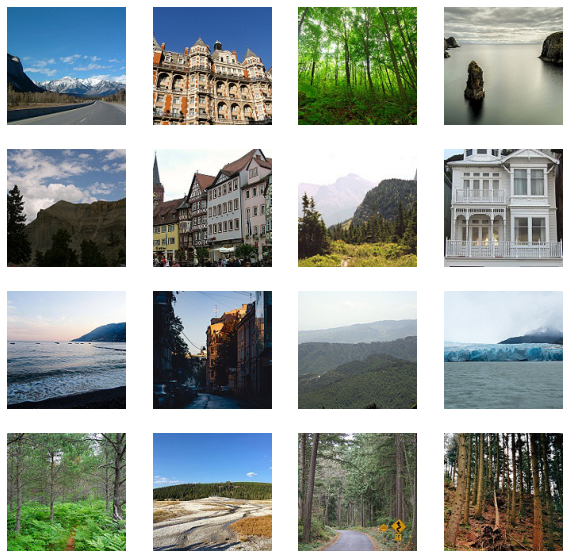

In [7]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img in zip(axes.flatten(), train_imgs):
    ax.imshow(Image.open(img))
    ax.axis("off")

# The Network

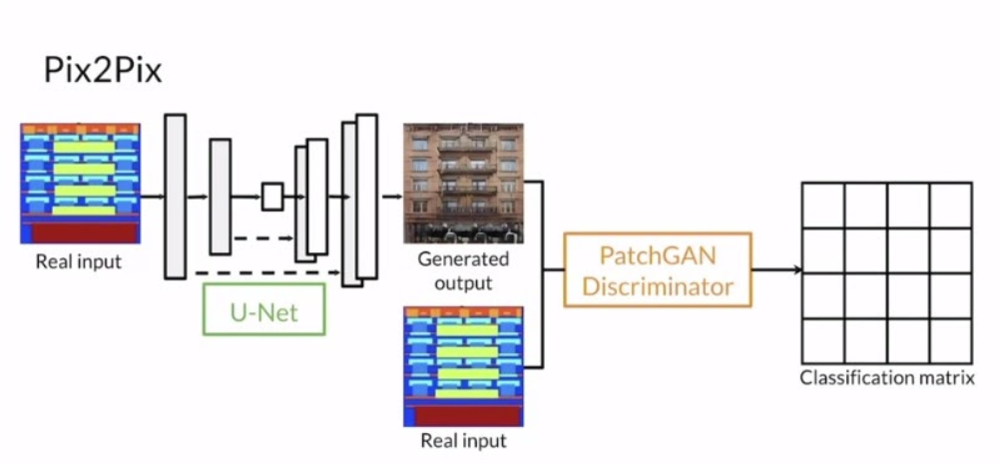

The strategy:
The image generation process has been updated from a Decoder network to an UNet AutoEncoder, which is known for its ability to generate masks and realistic looking images. The UNet AutoEncoder was selected for its efficient architecture and high quality results, although it has been modified to follow GAN training guidelines. One notable change is that the generator no longer takes in noise but instead performs a domain transfer to generate images of the target mask. The Generator architecture is referred to as PatchGAN and outputs zeros or ones of a specific patch size as per the target labels. The discriminator's input has also been updated to take in both the target image and the generated image to determine if the generated image is the mask image of the target image.

According to the paper:
The training procedure is similar to a regular GAN with the addition of two loss functions: Binary Crossentropy for the discriminator and Mean Absolute Error(L1 Loss) for the generator to focus on producing images close to the target images while the discriminator focuses on discriminating the images.

LcGAN (G, D) =Ex,y[log D(x, y)]+Ex,z[log(1 − D(x, G(x, z))]

The goal of a conditional GAN is to minimize the objective function LcGAN(G, D), which is a combination of two terms. The first term is the expectation of the logarithm of the discriminator output for real image x and its corresponding target image y. The second term is the expectation of the logarithm of the discriminator output for real image x and the fake image G(x, z), where z is a noise vector. The discriminator tries to maximize this objective while the generator tries to minimize it.

To assess the importance of conditioning the discriminator, an unconditional variant is compared where the discriminator does not observe the real image x. In this case, the objective function LGAN(G, D) is a combination of the expectation of the logarithm of the discriminator output for its corresponding target image y and the expectation of the logarithm of the discriminator output for the fake image G(x, z).

Previous approaches have used a combination of the GAN objective with a traditional loss function, such as L2 distance, to encourage the generator to be close to the ground truth output. In this approach, the discriminator's job remains the same, while the generator is tasked to both deceive the discriminator and produce output that is close to the ground truth output in an L2 sense. In this study, L1 distance is used instead of L2 distance as it results in less blurring.

LL1(G) = Ex,y,z[ky − G(x, z)k1]

The final objective function is a combination of LcGAN(G, D) and LL1(G), where LL1(G) is the L1 distance between the ground truth output and the output of the generator. The parameter λ is used to control the weight of the LL1(G) term in the final objective function.

G*=arg min_G max_D LcGAN(G,D)+λLL1(G)

# 1.2. Making Datasets and DataLoaders

We are resizing the images and flipping horizontally (flipping only if it is training set) and then read an RGB image, convert it to Lab color space and separate the first (grayscale) channel and the color channels as inputs and targets for the models respectively. Then we are making the data loaders.

In [11]:
class ColorizationDataset(Dataset):
    def __init__(self, train=1):
        if train == 1:
            self.images = train_imgs
            self.transforms = transforms.Compose([
                transforms.Resize((256, 256),  Image.BICUBIC),
                transforms.RandomHorizontalFlip(), #Horizontal flip
                ])
        elif train == 0:
            self.images = val_imgs
            self.transforms = transforms.Resize((256, 256),  Image.BICUBIC)
        
        self.split = train
        self.size = 256
        self.images =  self.images
    
    def __getitem__(self, idx):
        img = Image.open(self.images[idx]).convert("RGB")
        img = self.transforms(img)
        img = np.array(img)
        img_lab = rgb2lab(img).astype("float32") # Converting RGB to L*a*b
        img_lab = transforms.ToTensor()(img_lab)
        L = img_lab[[0], ...] / 50. - 1. # Between -1 and 1
        ab = img_lab[[1, 2], ...] / 110. # Between -1 and 1
        
        return {'L': L, 'ab': ab}
    
    def __len__(self):
        return len(self.images)

traindataset = ColorizationDataset(train = 1)
trainloader = DataLoader(traindataset, batch_size=100, shuffle=True, num_workers=0)

valdataset = ColorizationDataset(train = 0)
valloader = DataLoader(valdataset, batch_size=100, num_workers=0)

In [12]:
data = next(iter(trainloader))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)

torch.Size([100, 1, 256, 256]) torch.Size([100, 2, 256, 256])


#1.3. Unet block 

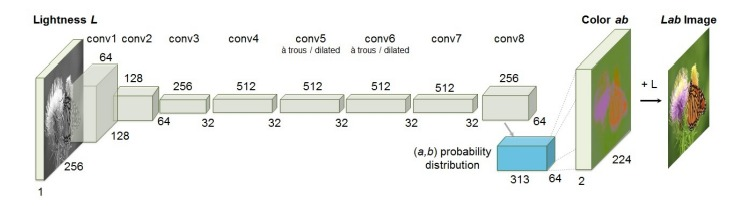

The Generator proposed by the paper is a U-Net architecture for image colorization, which is a popular image segmentation model that uses an encoder-decoder architecture with skip connections to improve accuracy.

In [13]:
class UnetBlock(nn.Module):
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        super().__init__()
        self.outermost = outermost
        if input_c is None: input_c = nf
        downconv = nn.Conv2d(input_c, ni, kernel_size=4,
                             stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)
        
        if outermost:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1)
            down = [downconv]
            up = [uprelu, upconv, nn.Tanh()]
            model = down + [submodule] + up
        elif innermost:
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv]
            up = [uprelu, upconv, upnorm]
            model = down + up
        else:
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4,
                                        stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]
            up = [uprelu, upconv, upnorm]
            if dropout: up += [nn.Dropout(0.5)]
            model = down + [submodule] + up
        self.model = nn.Sequential(*model)
    
    def forward(self, x):
        if self.outermost:
            return self.model(x)
        else:
            return torch.cat([x, self.model(x)], 1)

class Unet(nn.Module):
    def __init__(self, input_c=1, output_c=2, n_down=16, num_filters=64):
        super().__init__()
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        for _ in range(n_down - 13):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)
    
    def forward(self, x):
        return self.model(x)

In [14]:
Gen = Unet()
print(Gen)

Unet(
  (model): UnetBlock(
    (model): Sequential(
      (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): UnetBlock(
        (model): Sequential(
          (0): LeakyReLU(negative_slope=0.2, inplace=True)
          (1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
          (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (3): UnetBlock(
            (model): Sequential(
              (0): LeakyReLU(negative_slope=0.2, inplace=True)
              (1): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
              (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (3): UnetBlock(
                (model): Sequential(
                  (0): LeakyReLU(negative_slope=0.2, inplace=True)
                  (1): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
 

#1.4. Discriminator

The architecture of our discriminator is rather straight forward. This code implements a model by stacking blocks of Conv-BatchNorm-LeackyReLU to decide whether the input image is fake or real.

Why use PatchDiscriminator? This Discriminator works by classifying each patch of an input image as real or fake, rather than classifying the entire image as real or fake.

The advantage of using PatchDiscriminator is that it can provide more detailed feedback on the quality of the generated images. By evaluating each patch of an image separately, the discriminator can provide feedback on both local and global features, which can be useful in improving the overall quality of the generated image.

In [15]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=6):
        super().__init__()
        model = [self.get_layers(input_c, num_filters, norm=False)]
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                          for i in range(n_down)] # the 'if' statement is taking care of not using
                                                  # stride of 2 for the last block in this loop
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)] # Make sure to not use normalization or
                                                                                             # activation for the last layer of the model
        self.model = nn.Sequential(*model)                                                   
        
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True): # when needing to make some repeatitive blocks of layers,
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]          # it's always helpful to make a separate method for that purpose
        if norm: layers += [nn.BatchNorm2d(nf)]
        if act: layers += [nn.LeakyReLU(0.2, True)]
        return nn.Sequential(*layers)
    
    def forward(self, x):
        return self.model(x)

In [16]:
Dis = PatchDiscriminator(6)
print(Dis)

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

In [29]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(100, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([100, 1, 2, 2])

#1.5. Loss function and weights


In this class we calculate the GAN loss for our model. we dicided to use BCEWithLogitsLoss() and register constant tensors as "real" and "fake" labels.
Then when we call this module, it makes an appropriate tensor full of zeros or ones and computes the loss. 

In [18]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        super().__init__()
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
#        if gan_mode == 'vanilla':
        self.loss = nn.BCEWithLogitsLoss()
#        elif gan_mode == 'lsgan':
#            self.loss = nn.MSELoss()
    
    def get_labels(self, preds, target_is_real):
        if target_is_real:
            labels = self.real_label
        else:
            labels = self.fake_label
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        labels = self.get_labels(preds, target_is_real)
        loss = self.loss(preds, labels)
        return loss

In [19]:

def init_weights(net, init='norm', gain=0.02):
    
    
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)
            
    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net

def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model


#1.6. Main model

In [20]:
class MainModel(nn.Module):
    def __init__(self, net_G=None, lr_G=1e-4, lr_D=1e-4, 
                 beta1=0.5, beta2=0.79, lambda_L1=100.):
        super().__init__()
        
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1
        
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), self.device)
        else:
            self.net_G = net_G.to(self.device)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), self.device)
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad
        
    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())
        self.loss_D_fake = self.GANcriterion(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()
    
    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()
    
    def optimize(self):
        self.forward()
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()
        self.backward_D()
        self.opt_D.step()
        
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)
        self.opt_G.zero_grad()
        self.backward_G()
        self.opt_G.step()

#1.7. Utility functions

In [25]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict,losses1, count):
    i = 0
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)
        losses1[i].append(loss_meter.avg)
        i+=1
    return losses1

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def acc(model, data):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    L = model.L
    real_imgs = lab_to_rgb(L, real_color)
    criterion = nn.MSELoss()
    ssim_value = 0
    mse_value = 0
    for i in range(100):
        ssim_value = ssim_value + ssim(real_imgs[i], fake_imgs[i], multichannel=True)
        mse_value = mse_value + (1 - criterion(torch.tensor(real_imgs), torch.tensor(fake_imgs)).item())
    mse_accuracy = ((mse_value)/100)*100
    ssim_accuracy = ((ssim_value.item())/len(fake_imgs)+1)*50
    return mse_accuracy, ssim_accuracy    

def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

#1.8. Train the model

##Benchmarks:
In image colorization with U-Net and GAN, several metrics can be used to evaluate the quality of the generated images. Two commonly used metrics are MSE (Mean Square Error) and SSIM (Structural Similarity Index). MSE measures the average of the squared differences between each pixel value of the original and reconstructed images. The larger the value of MSE, the greater the difference between the original and reconstructed images. SSIM compares the structural information of two images by measuring their perceived similarity. Higher SSIM values indicate better image quality.

model initialized with norm initialization
model initialized with norm initialization


  0%|          | 0/60 [00:00<?, ?it/s]

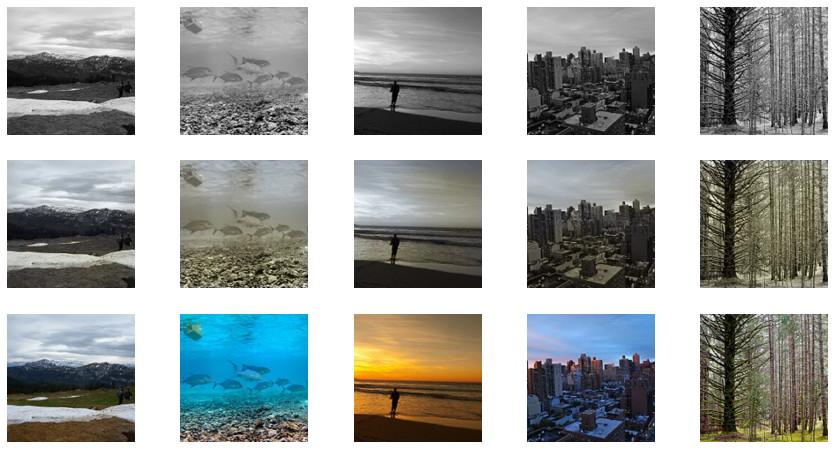


Epoch 1/15
Iteration 60/60
loss_D_fake: 0.61684
loss_D_real: 0.61957
loss_D: 0.61820
loss_G_GAN: 0.97061
loss_G_L1: 9.63511
loss_G: 10.60573


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


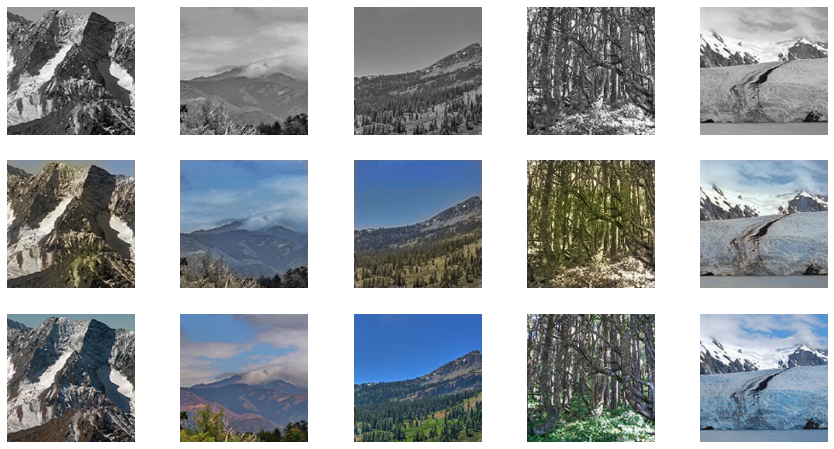


Epoch 2/15
Iteration 60/60
loss_D_fake: 0.52558
loss_D_real: 0.55383
loss_D: 0.53970
loss_G_GAN: 1.09294
loss_G_L1: 8.06034
loss_G: 9.15329


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 146 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color

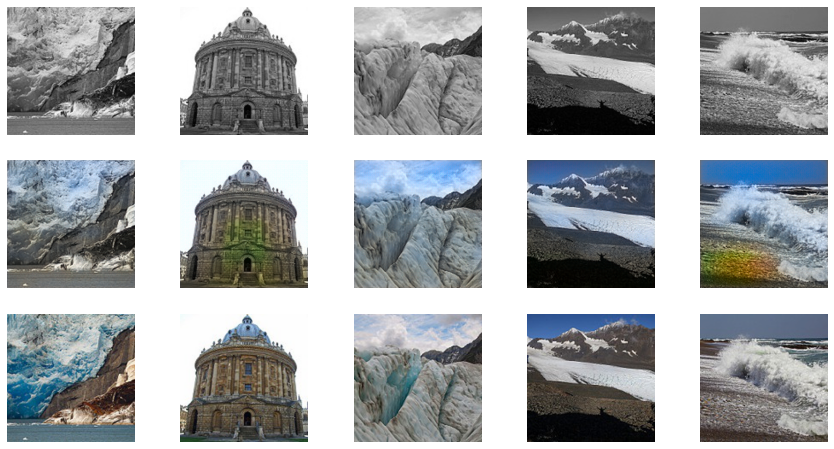


Epoch 3/15
Iteration 60/60
loss_D_fake: 0.56746
loss_D_real: 0.57270
loss_D: 0.57008
loss_G_GAN: 1.08978
loss_G_L1: 8.06138
loss_G: 9.15116


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 30 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


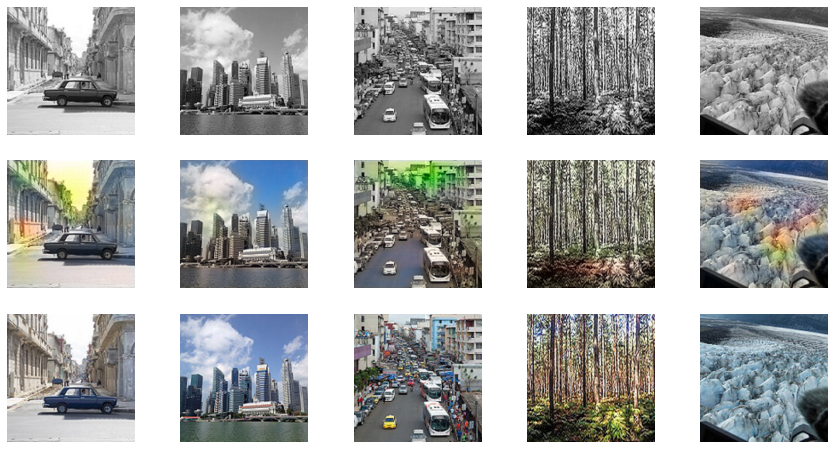


Epoch 4/15
Iteration 60/60
loss_D_fake: 0.56225
loss_D_real: 0.57339
loss_D: 0.56782
loss_G_GAN: 1.07008
loss_G_L1: 8.04511
loss_G: 9.11519


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 69 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 43 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 73 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 63 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color

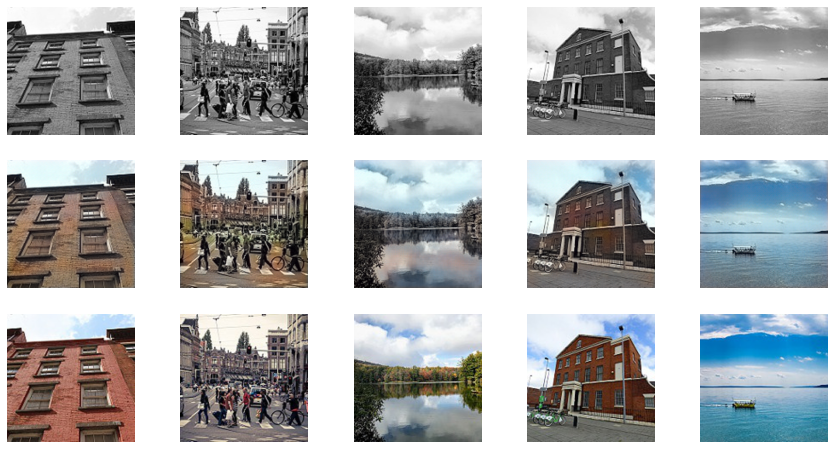


Epoch 5/15
Iteration 60/60
loss_D_fake: 0.57413
loss_D_real: 0.57292
loss_D: 0.57352
loss_G_GAN: 1.07331
loss_G_L1: 7.99830
loss_G: 9.07161


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 46 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 33 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 51 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 31 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color

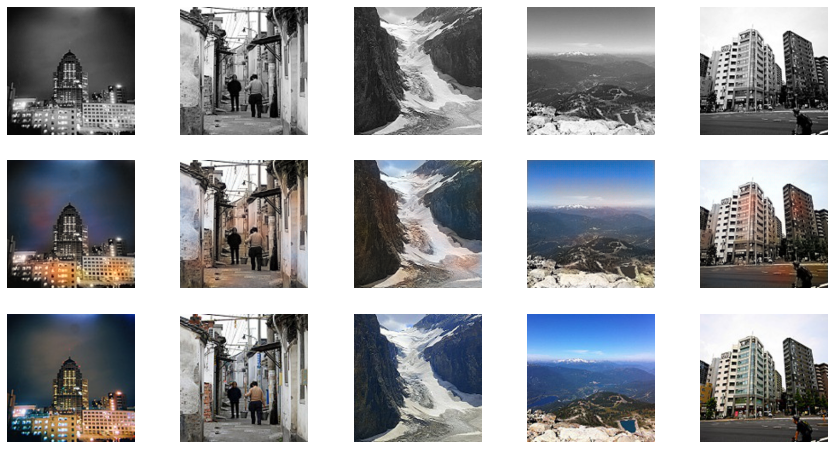


Epoch 6/15
Iteration 60/60
loss_D_fake: 0.58128
loss_D_real: 0.60877
loss_D: 0.59503
loss_G_GAN: 1.03019
loss_G_L1: 8.04432
loss_G: 9.07451


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 85 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


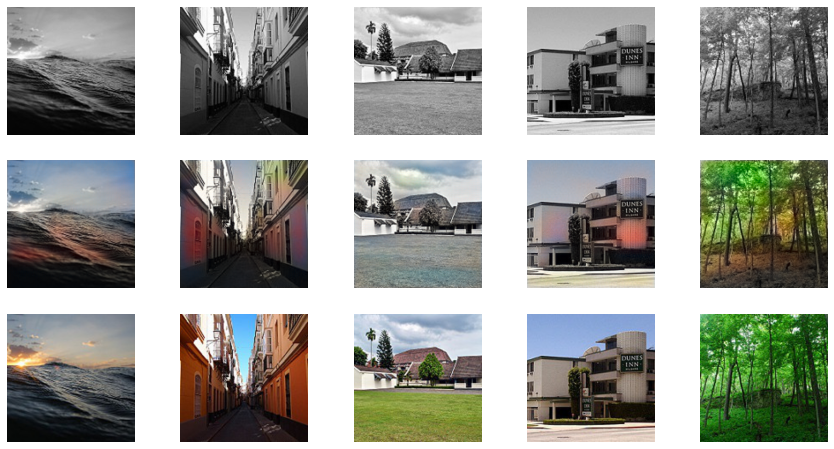


Epoch 7/15
Iteration 60/60
loss_D_fake: 0.58577
loss_D_real: 0.59719
loss_D: 0.59148
loss_G_GAN: 1.02088
loss_G_L1: 7.95915
loss_G: 8.98003


  0%|          | 0/60 [00:00<?, ?it/s]

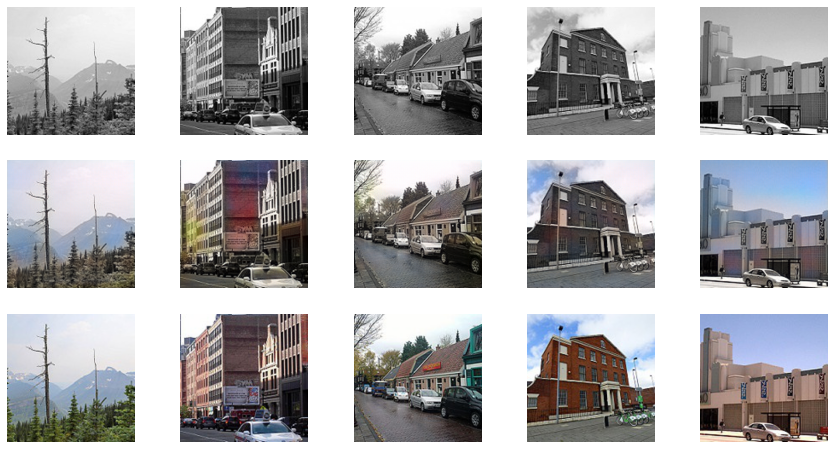


Epoch 8/15
Iteration 60/60
loss_D_fake: 0.59488
loss_D_real: 0.61432
loss_D: 0.60460
loss_G_GAN: 0.99928
loss_G_L1: 7.92389
loss_G: 8.92316


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 28 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


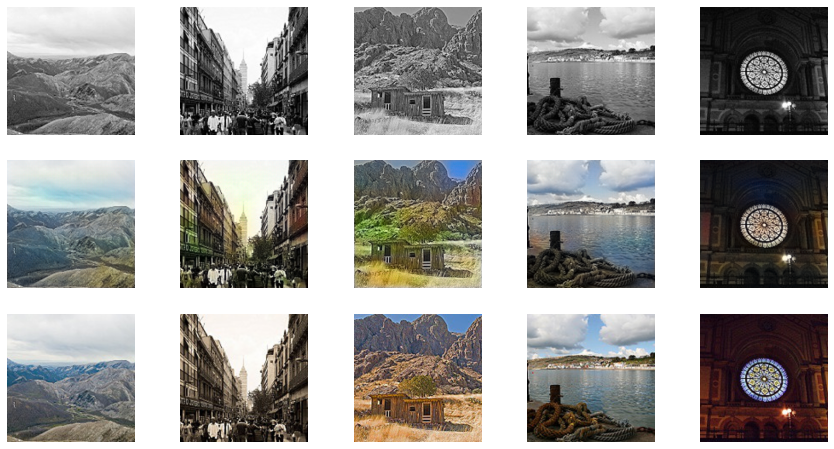


Epoch 9/15
Iteration 60/60
loss_D_fake: 0.61054
loss_D_real: 0.62347
loss_D: 0.61700
loss_G_GAN: 0.95234
loss_G_L1: 7.86823
loss_G: 8.82057


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 36 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 27 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


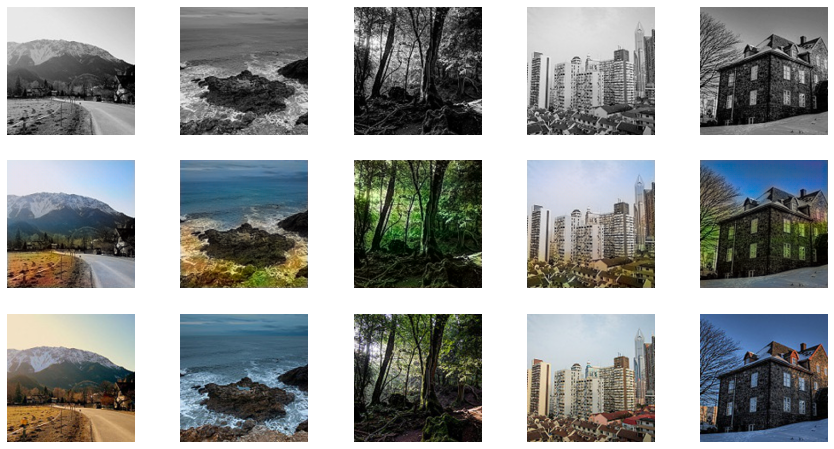


Epoch 10/15
Iteration 60/60
loss_D_fake: 0.60560
loss_D_real: 0.62343
loss_D: 0.61451
loss_G_GAN: 0.96816
loss_G_L1: 7.78674
loss_G: 8.75490


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 114 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 83 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 41 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 321 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 130 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Co

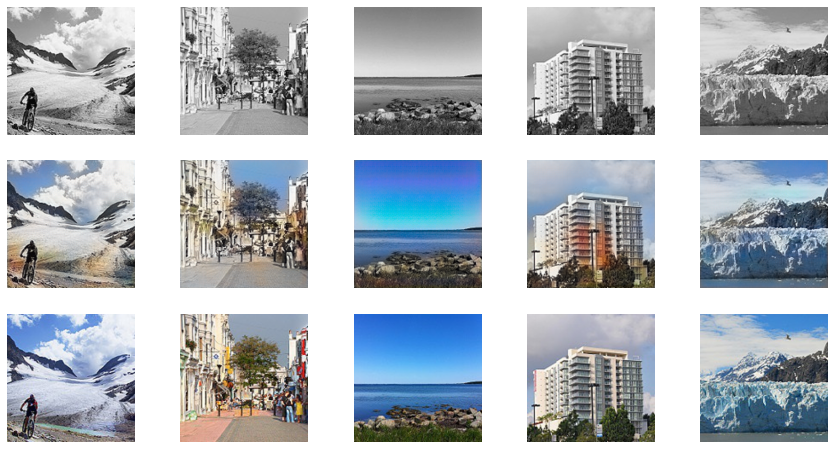


Epoch 11/15
Iteration 60/60
loss_D_fake: 0.60533
loss_D_real: 0.61666
loss_D: 0.61099
loss_G_GAN: 0.97402
loss_G_L1: 7.67396
loss_G: 8.64798


  0%|          | 0/60 [00:00<?, ?it/s]

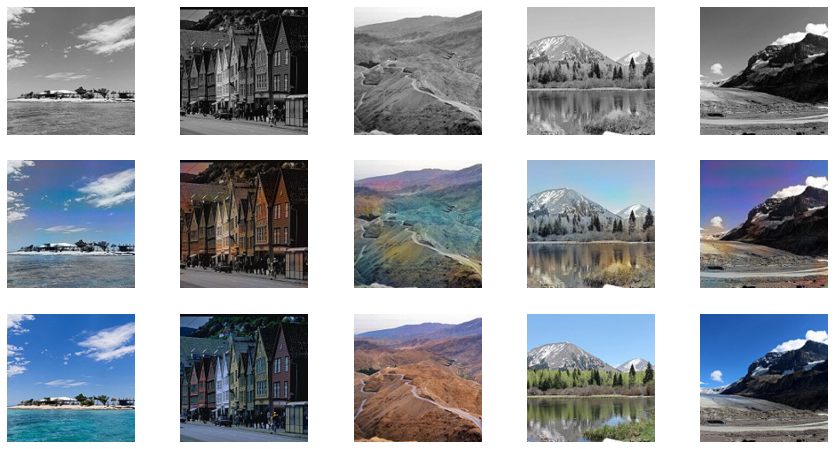


Epoch 12/15
Iteration 60/60
loss_D_fake: 0.61898
loss_D_real: 0.62447
loss_D: 0.62172
loss_G_GAN: 0.94304
loss_G_L1: 7.57393
loss_G: 8.51696


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 38 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 57 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


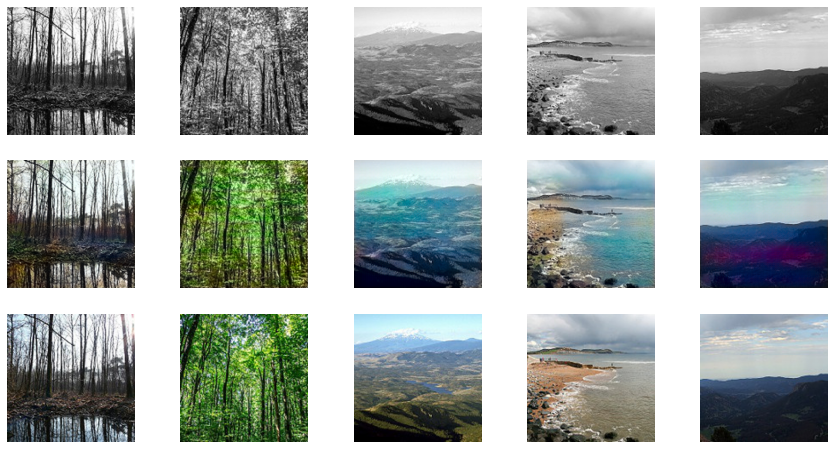


Epoch 13/15
Iteration 60/60
loss_D_fake: 0.61351
loss_D_real: 0.61937
loss_D: 0.61644
loss_G_GAN: 0.94537
loss_G_L1: 7.45614
loss_G: 8.40151


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 76 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


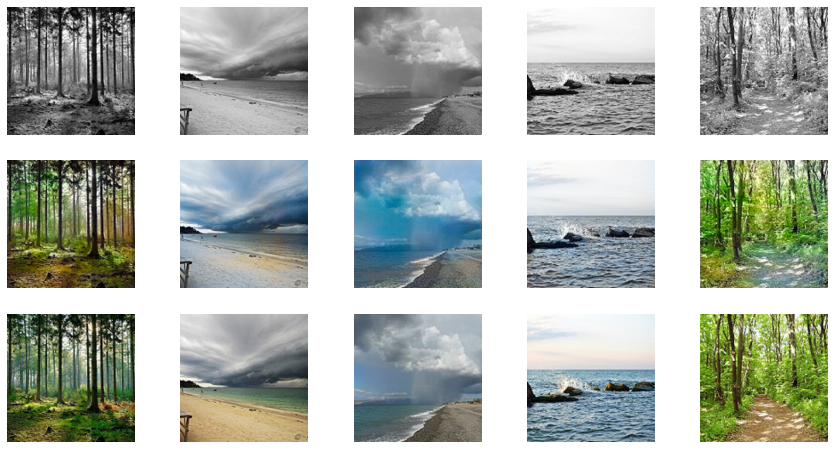


Epoch 14/15
Iteration 60/60
loss_D_fake: 0.59787
loss_D_real: 0.63178
loss_D: 0.61483
loss_G_GAN: 0.96746
loss_G_L1: 7.29588
loss_G: 8.26334


  0%|          | 0/60 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 58 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


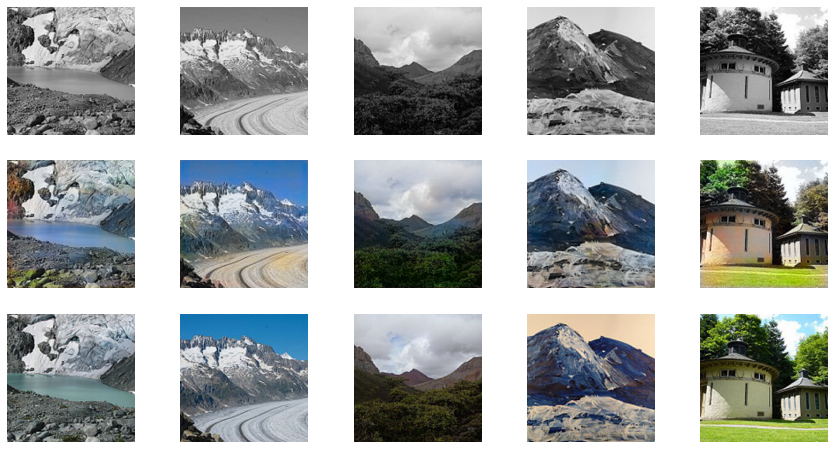


Epoch 15/15
Iteration 60/60
loss_D_fake: 0.61025
loss_D_real: 0.62374
loss_D: 0.61700
loss_G_GAN: 0.94669
loss_G_L1: 7.21075
loss_G: 8.15744


In [28]:
def train_model(model, train_dl, epochs, display_every=60):
    losses =[[] for i in range(6)]
    ssim_acc = []
    mse_acc = []
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(trainloader):
            model.setup_input(data) 
            model.optimize()
            losses1 = update_losses(model, loss_meter_dict,losses,count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                visualize(model, data, save=True) # function displaying the model's outputs
                ssim_accuracy, mse_accuracy = acc(model,data) #function to calculte accuracy with mse and ssim
                ssim_acc.append(ssim_accuracy)
                mse_acc.append(mse_accuracy)
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
        
    return losses1, mse_acc, ssim_acc    
model = MainModel()
losses1, mse_acc, ssim_acc = train_model(model, trainloader, 15)

#1.9. Evaluate the model

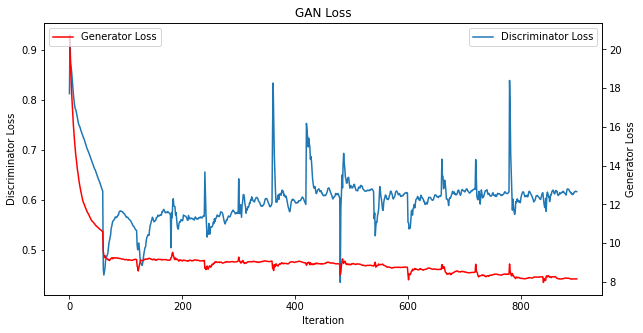

In [31]:
fig, ax1 = plt.subplots(figsize=(10,5))
plt.title('GAN Loss')
ax2 = ax1.twinx()
ax1.plot(losses1[2])
ax1.set_ylabel('Discriminator Loss')
ax1.set_xlabel('Iteration')
ax2.plot(losses1[5],'r')
ax2.set_ylabel('Generator Loss')
ax1.legend(['Discriminator Loss'])
ax2.legend(['Generator Loss'],loc ="upper left")

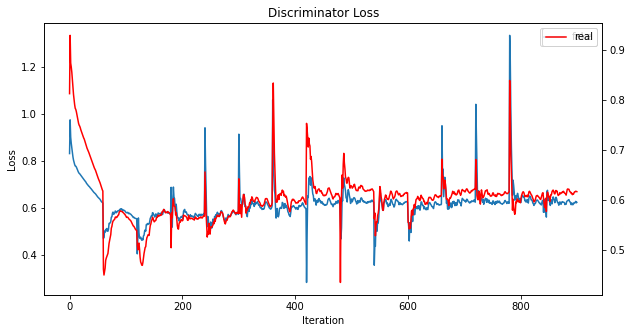

In [32]:
fig, ax1 = plt.subplots(figsize=(10,5))
plt.title('Discriminator Loss')
ax2 = ax1.twinx()
ax1.plot(losses1[1])
ax1.set_ylabel('Loss')
ax1.set_xlabel('Iteration')
ax2.plot(losses1[2],'r')
ax1.legend(['fake'])
ax2.legend(['real'])

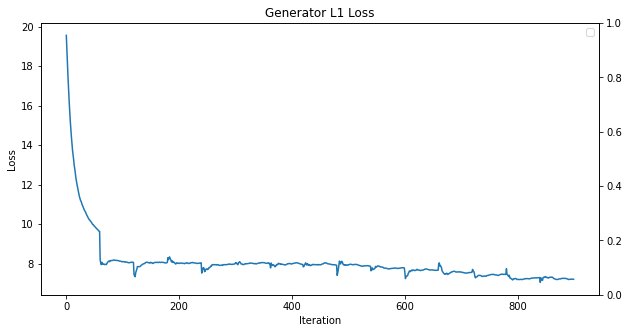

In [33]:
fig, ax1 = plt.subplots(figsize=(10,5))
plt.title('Generator L1 Loss')
ax2 = ax1.twinx()
ax1.plot(losses1[4])
ax1.set_ylabel('Loss')
ax1.set_xlabel('Iteration')
ax2.legend(['L1 loss'])

#1.10. Validation results

Printing the validation images to see the results from the trained model.

## The first line is the grayscale images,
##The second line is the generated images
##And the third line it the original colored images

  0%|          | 0/12 [00:00<?, ?it/s]

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data

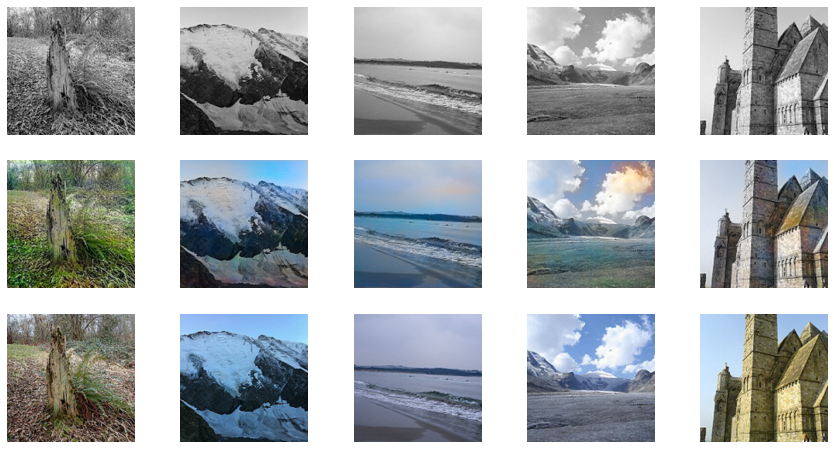

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


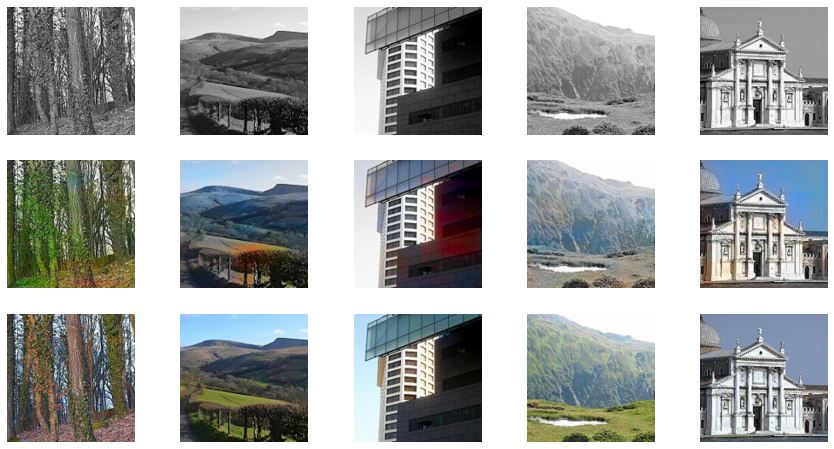

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


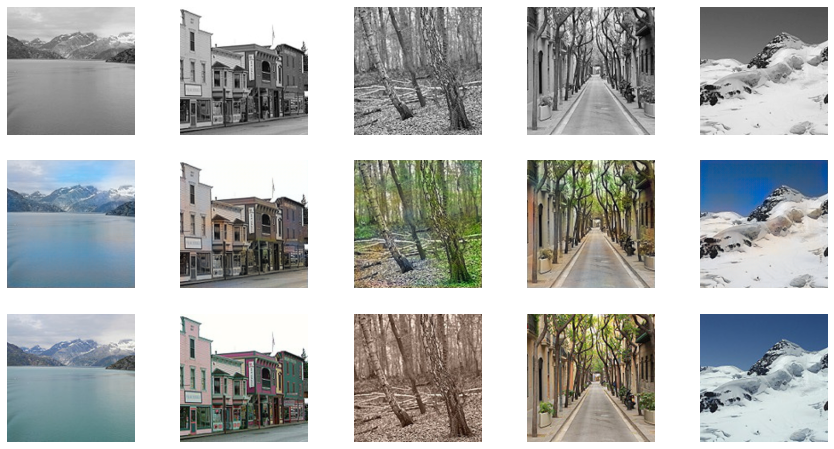

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 79 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


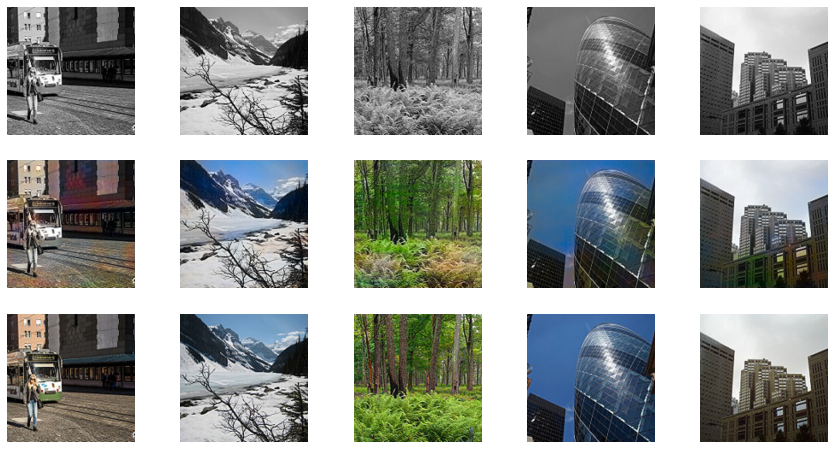

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


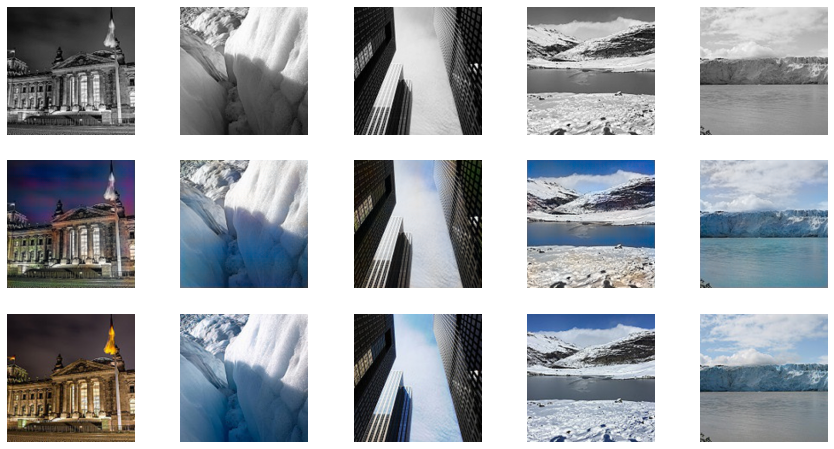

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


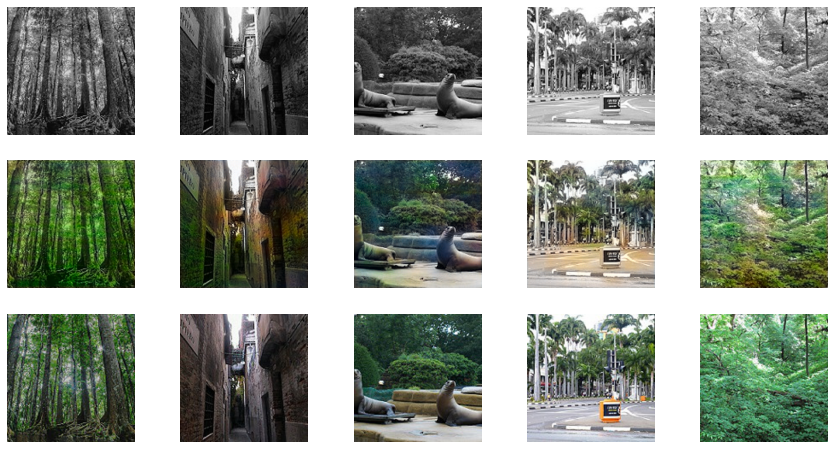

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 26 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


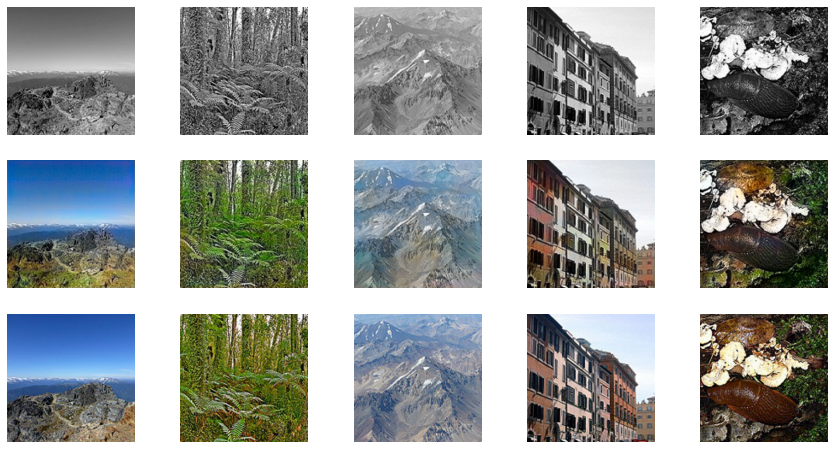

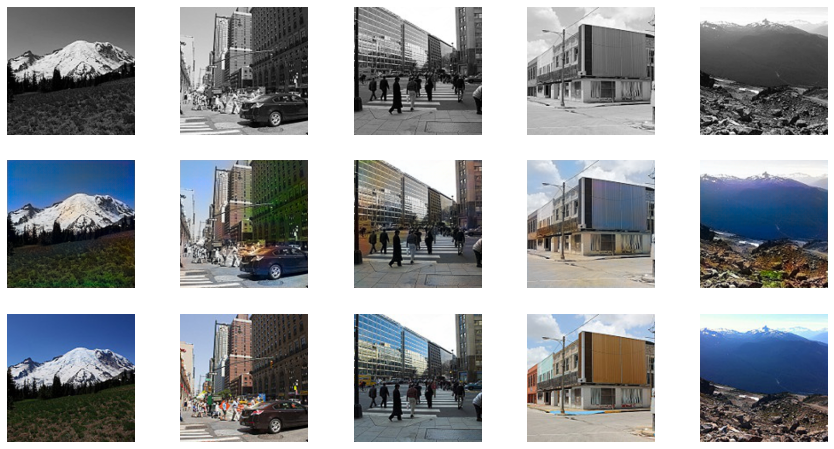

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


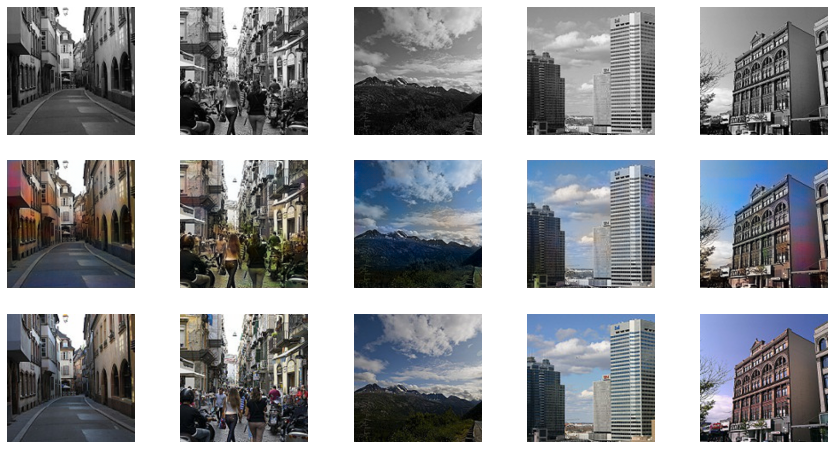

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 32 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


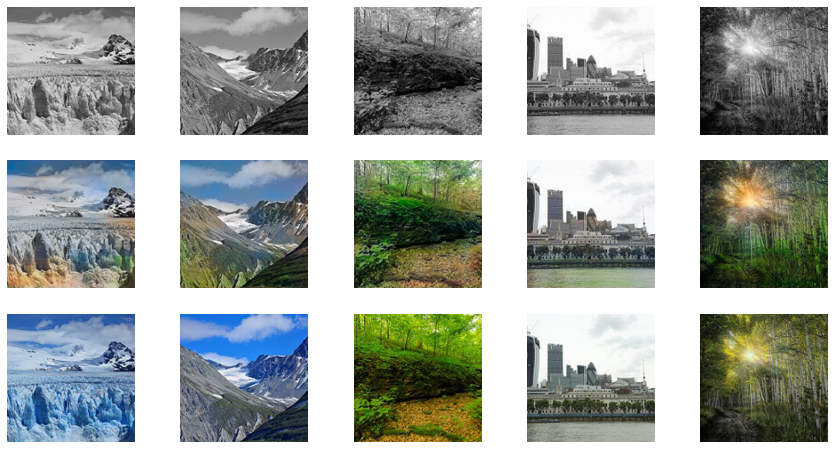

/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.8/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 17 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


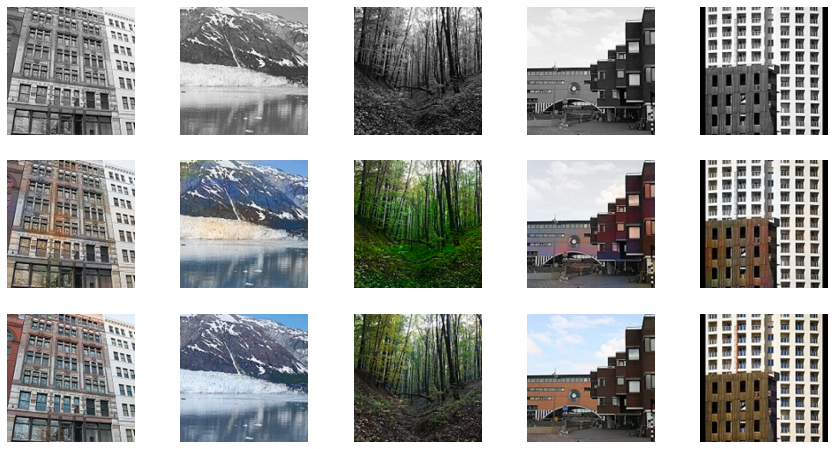

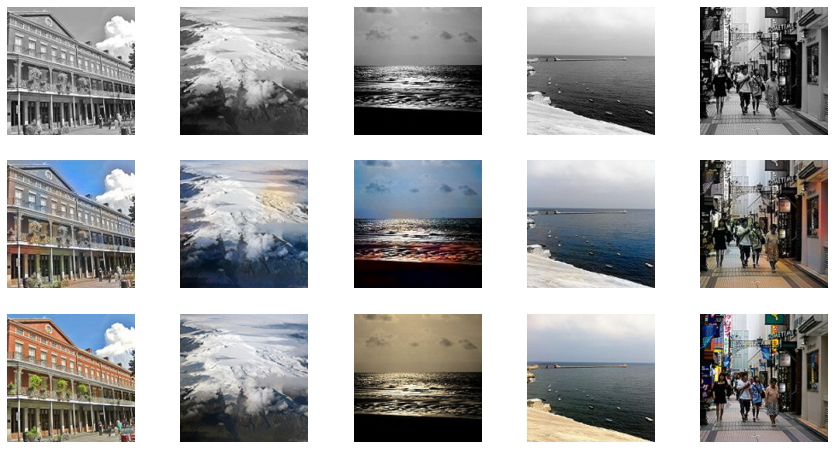

In [36]:
i=0
for data in tqdm(valloader):
    model.setup_input(data)
    i += 1
    visualize(model,data)

#Resutls
We can see from the validation images that the network is capable of producing impressive and realistic colorizations of grayscale images.
The use of a large dataset with a wide range of color images can improve the network's ability to generate accurate colorizations.
We see that it is possible to achieve a good colorization so that it is difficult to notice anything unusual, however, compared to the original photos there are still differences in color shades and sometimes in whole colors.
Large objects like sea, trees and sky colored in the right colors.


#Conclusions
In our project we used deep learning tools acquired during the course in particular, Generative adversarial network, to examine and achieve our milestones.

We decided to use to the UNet model because it is designed specifically for image segmentation tasks. Its architecture allows it to capture more details with the skip-connections that allows it to preserve the information from the earlier layers of the network. This helps in retaining the details and color information of the original image, reducing the loss of information during colorization.

Our data based on specific type of images (landscapes), for expanding the use of our model we can use a larger database of other type of images to expand the applications of this network for further work.

In conclusion, we presented results that the colorization network using a  GAN model has demonstrated a significant improvement in the quality and realism of the colorized images.



#References
1)Phillip Isola, Jun-Yan Zhu, Tinghui Zhou, Alexei A. Efros
"Image-to-Image Translation with Conditional Adversarial Networks"

2)Richard Zhang, Phillip Isola, Alexei A. Efros "Colorful Image Colorization"

3)Landscape dataset : [Kaggle](https://www.kaggle.com/datasets/theblackmamba31/landscape-image-colorization)